Benchmarking xarray netcdf vs xarray zarr using Dask Local cluster.
Two chunking test cases for NetCDF is also in this notebook.

For general info on GFDL specific Python/Jupyter/Anaconda, please checkout http://wiki.gfdl.noaa.gov/Python. It also has information on port for
Data citation

Zhao, Ming; Blanton, Chris; John, Jasmin G; Radhakrishnan, Aparna; Zadeh, Niki T.; McHugh, Colleen; Rand, Kristopher; Vahlenkamp, Hans; Wilson, Chandin; Ginoux, Paul; Malyshev, Sergey; Wyman, Bruce; Guo, Huan; Balaji, V; Held, Isaac M; Dunne, John P.; Winton, Michael; Adcroft, Alistair; Milly, P.C.D; Shevliakova, Elena; Knutson, Thomas; Ploshay, Jeffrey; Zeng, Yujin (2018). NOAA-GFDL GFDL-CM4C192 model output prepared for CMIP6 HighResMIP. Version 20180701 [1].Earth System Grid Federation. https://doi.org/10.22033/ESGF/CMIP6.2262




User input: Dask analysis template

In [1]:
import os 
clusterType = "SLURM" #or SLURM or Local
platform = "PPAN"
numCores = 6
numWorkers = 6
mem='48GB'
varname='tas'
dashPort = ':1984'
if (platform == "PPAN"):
    logdir = '/work/a1r/dask/logs/'
    localdir = '' #We will set local directory when we define the cluster
else:
    logdir = '/local2/home/a1r/logs/'
    localdir = logdir
print("Logs:", logdir)

res_nc = {} #settings, time
res_zarr = {} #settings, time

Logs: /work/a1r/dask/logs/


In [2]:
# get the plot in notebook
%matplotlib inline
import xarray as xr 

Use dask.distributed task scheduler and launch DASK using SLURMcluster

In [3]:
from dask.distributed import Client

#Instantiate Dask client
if (clusterType == "local"):
    from dask.distributed import LocalCluster
    cluster = LocalCluster(dashboard_address=dashPort,local_directory=localdir)
else:
    from dask_jobqueue import SLURMCluster
    scheduler_options = {}
    scheduler_options["dashboard_address"] = dashPort
    cluster = SLURMCluster(queue='batch',memory=mem,project='gfdl_f',cores=numCores,walltime='2:60:00',
                           scheduler_options=scheduler_options,log_directory=logdir,
                           local_directory=(os.getenv('TMPDIR'))) 
    
cluster.scale(numWorkers)
client = Client(cluster)    
client

Client Scheduler: tcp://140.208.147.176:34764 Dashboard: http://140.208.147.176:1984/status,Cluster Workers: 0 Cores: 0 Memory: 0 B


In [45]:
dtype='zarr' #nc or zarr; TODO zipstore
if(dtype == 'zarr'):
    datadir = "/work/a1r/enes20/out/tas_3hr_2015-2051.zarr/"
else:
    datadir = '/work/a1r/enes20/CMIP6/HighResMIP/NOAA-GFDL/GFDL-CM4C192/highresSST-future/r1i1p1f1/3hr/'+varname+'/gr3/v20180701/'

if(dtype == 'zarr'):
    print("Case 1:",dtype)
    %time ds = xr.open_zarr(datadir) 
        
elif(dtype == 'nc'):
    customOptions = "chunks={'time': 10}"
    print("Case 2:",dtype,".",customOptions)
    %time ds = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 10}, combine='by_coords',parallel=True,decode_cf=False)
else:
    sys.exit("Pass zarr or netcdf only")

Case 1: zarr
CPU times: user 386 ms, sys: 26 ms, total: 412 ms
Wall time: 833 ms


In [46]:
ds['tas'].data

,Array,Chunk
Bytes,87.25 GB,8.29 MB
Shape,"(105192, 360, 576)","(10, 360, 576)"
Count,10521 Tasks,10520 Chunks
Type,float32,numpy.ndarray


In [19]:
temp_mean = ds[varname].mean(dim=['time'])

58.2 s ± 8.81 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


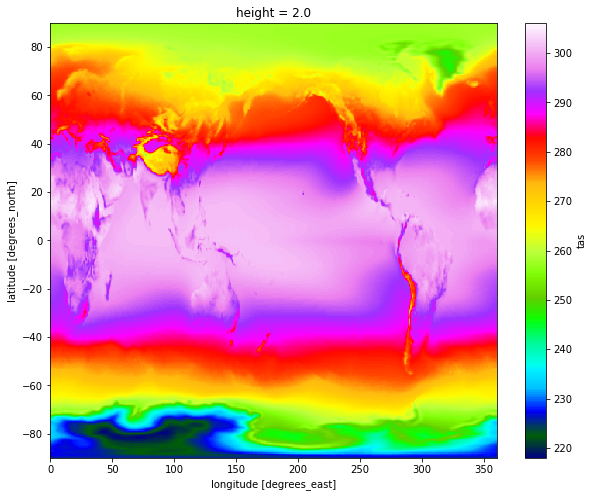

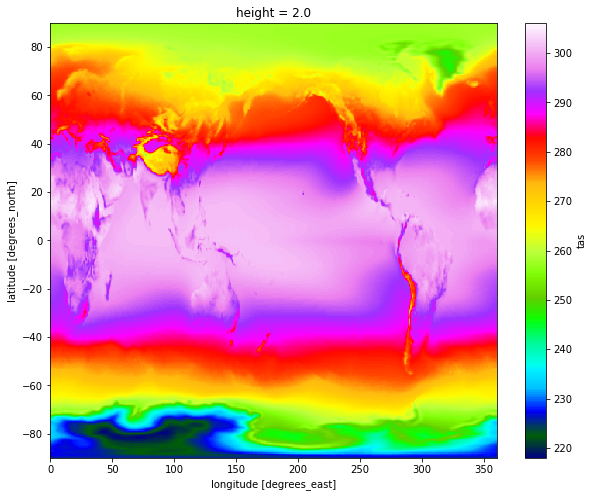

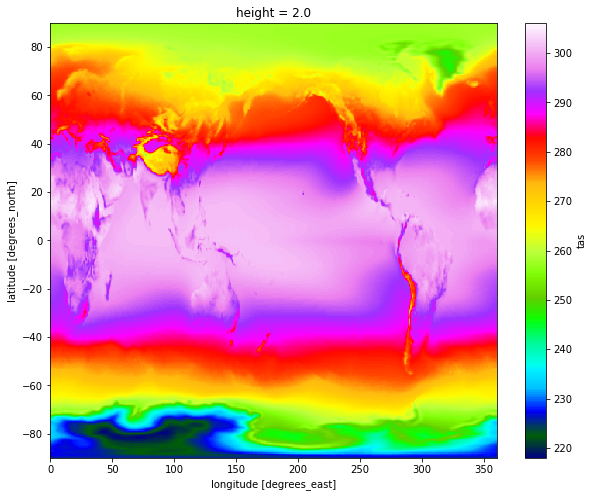

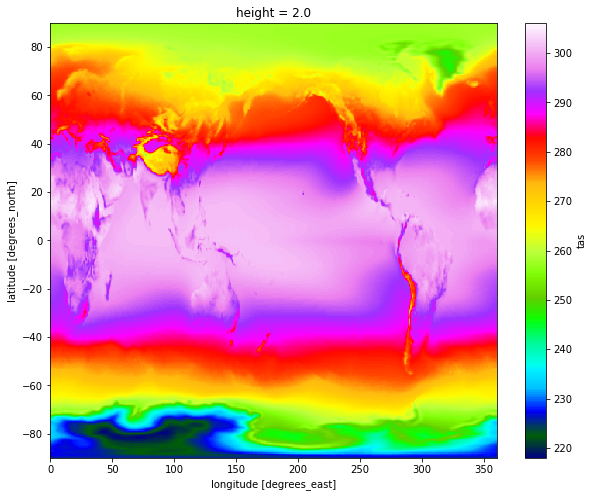

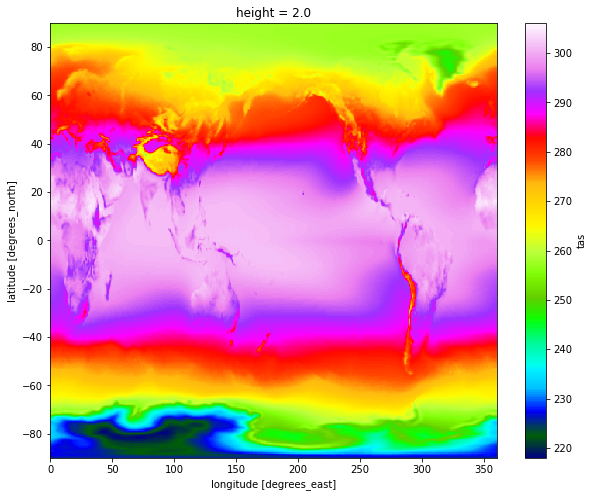

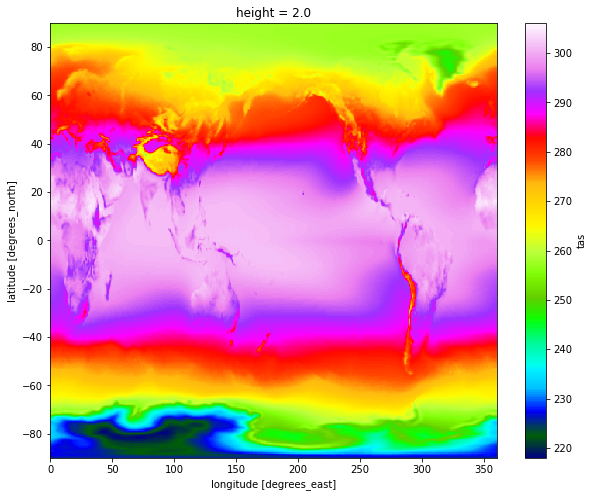

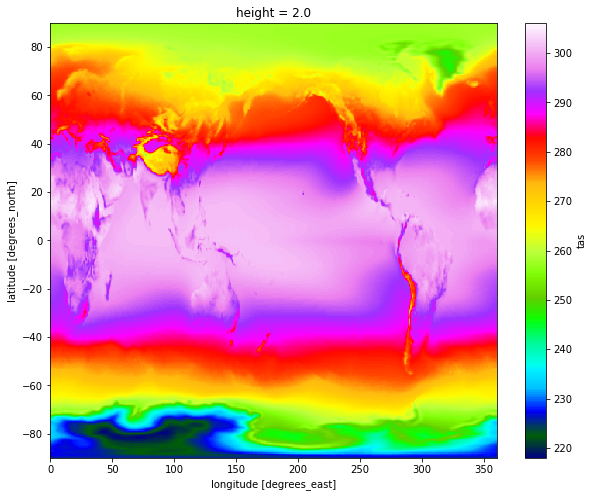

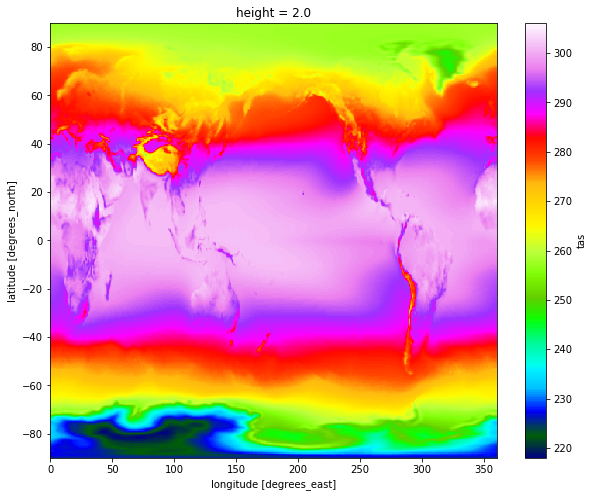

In [20]:
%timeit temp_mean.plot(figsize=[10, 8],cmap='gist_ncar') 

49.5 s ± 1.7 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


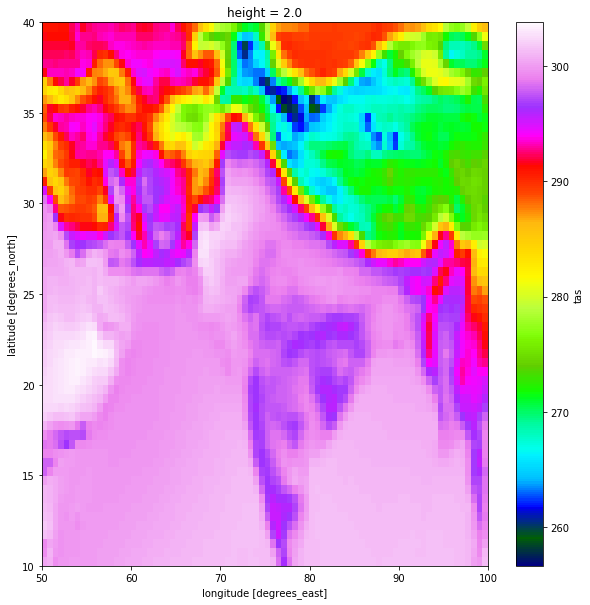

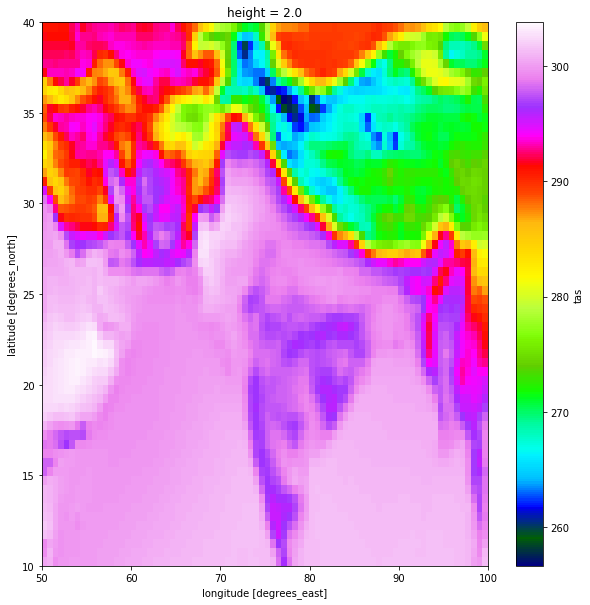

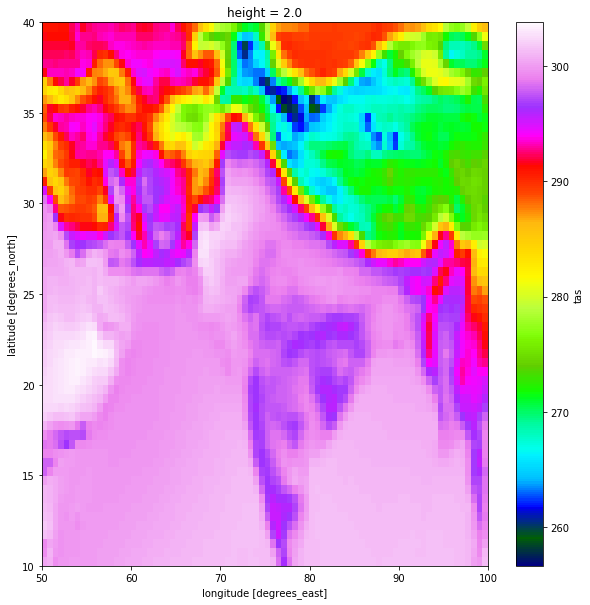

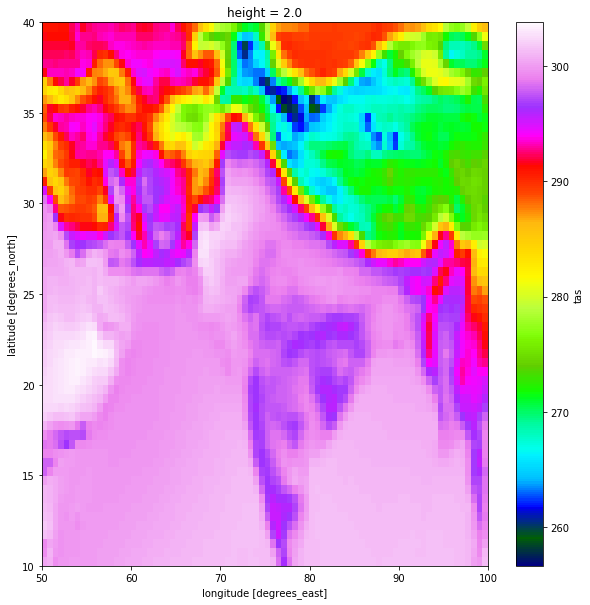

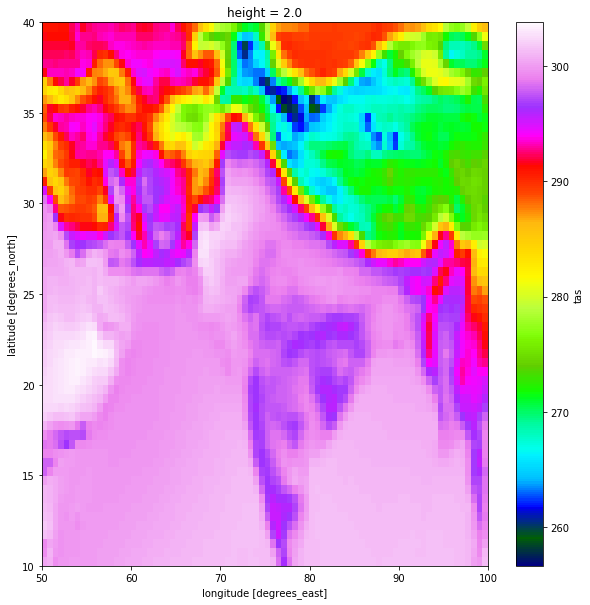

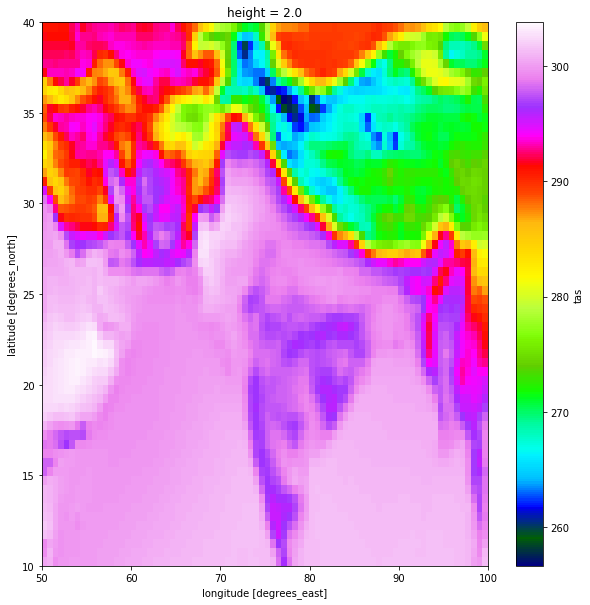

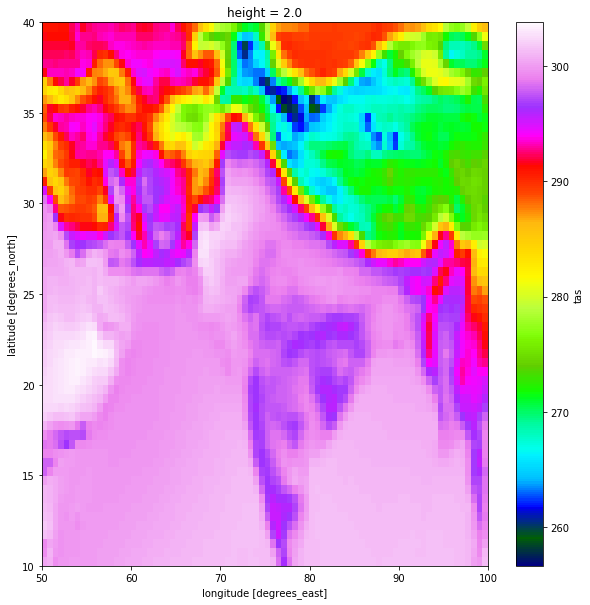

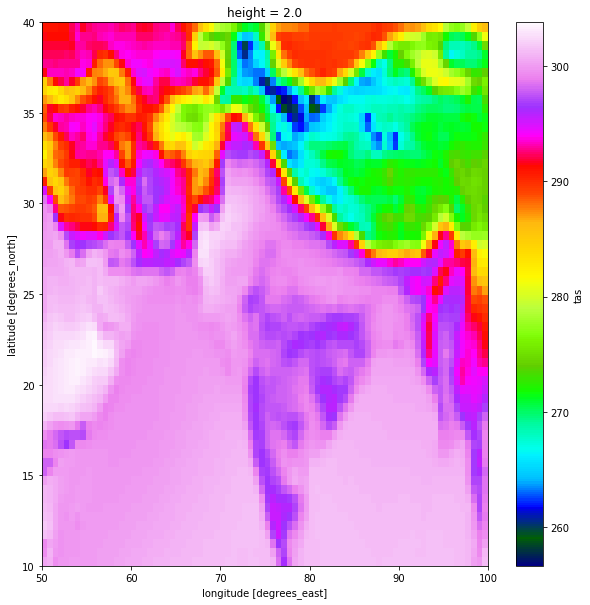

In [21]:
#India
%timeit temp_mean.loc[10:40,50:100].plot(figsize=[10, 10],cmap='gist_ncar')

In [25]:
#Case2: 
dtype='nc' #nc or zarr; TODO zipstore
if(dtype == 'zarr'):
    datadir = "/work/a1r/enes20/out/tas_3hr_2015-2051.zarr/"
else:
    datadir = '/work/a1r/enes20/CMIP6/HighResMIP/NOAA-GFDL/GFDL-CM4C192/highresSST-future/r1i1p1f1/3hr/'+varname+'/gr3/v20180701/'

if(dtype == 'zarr'):
    customOptions = ""
     #Test1
    print("Case 1:",dtype,".",customOptions)
    %time ds = xr.open_zarr(datadir) 
     
elif(dtype == 'nc'):
    customOptions = "chunks={'time': 10}"
    print("Case 2:",dtype,".",customOptions)
    %time ds = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 10}, combine='by_coords',parallel=True,decode_cf=False)
    ds = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 10}, combine='by_coords',parallel=True,decode_cf=False)

else:
    sys.exit("Pass zarr or netcdf only")


Case 2: nc . chunks={'time': 10}
CPU times: user 949 ms, sys: 48 ms, total: 997 ms
Wall time: 13.6 s


In [26]:
%timeit ds = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 10}, combine='by_coords',parallel=True,decode_cf=False)


13.1 s ± 364 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [43]:
ds['tas'].data

,Array,Chunk
Bytes,87.25 GB,8.29 MB
Shape,"(105192, 360, 576)","(10, 360, 576)"
Count,21042 Tasks,10520 Chunks
Type,float32,numpy.ndarray


In [27]:
temp_mean = ds[varname].mean(dim=['time'])

1min 25s ± 1.32 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


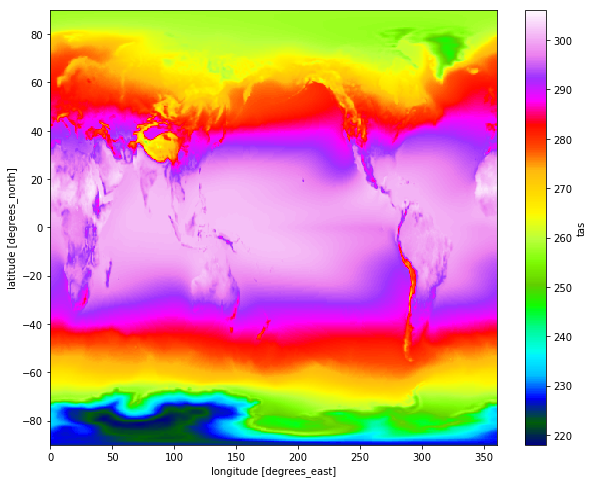

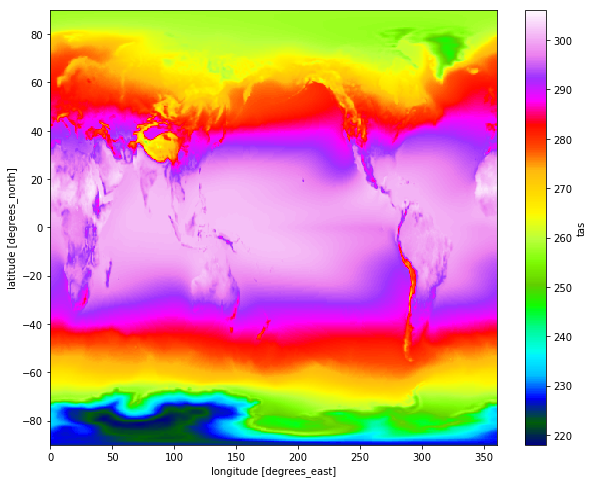

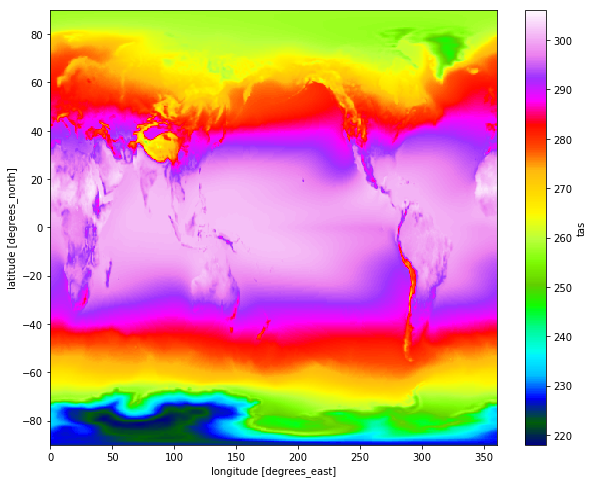

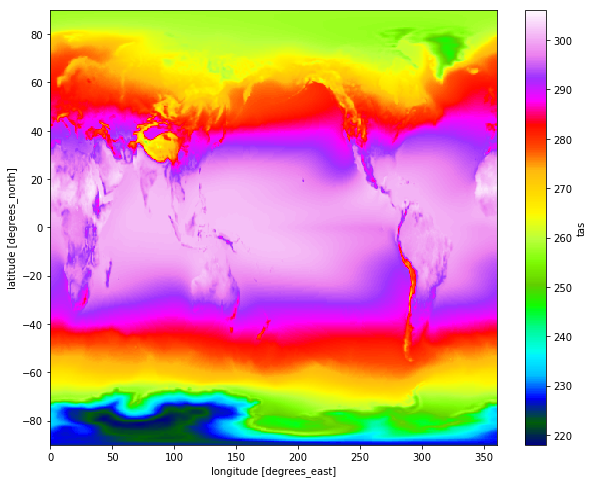

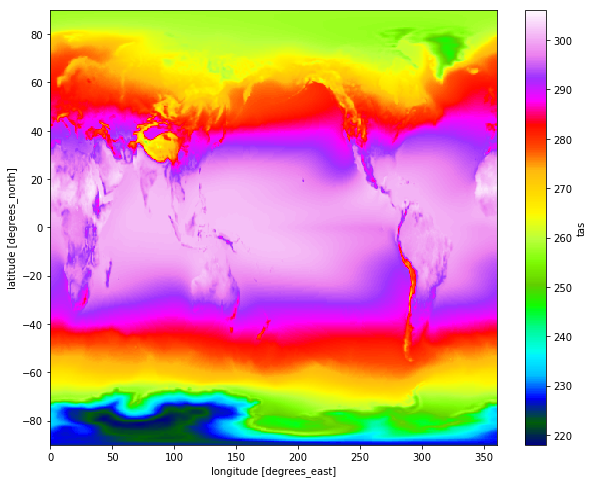

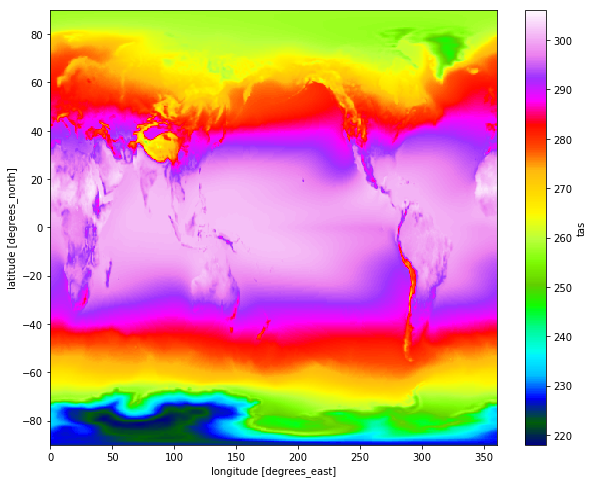

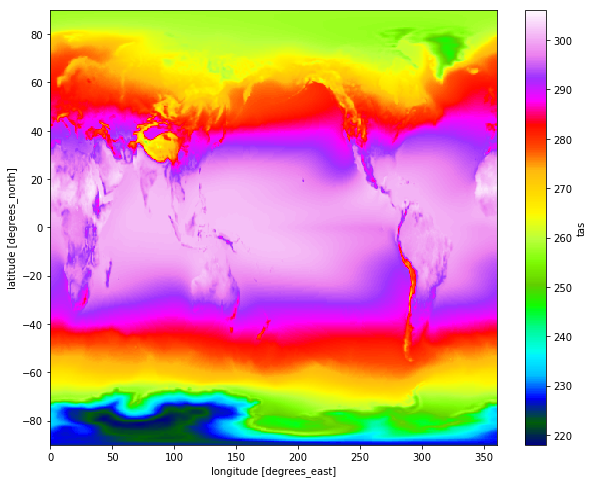

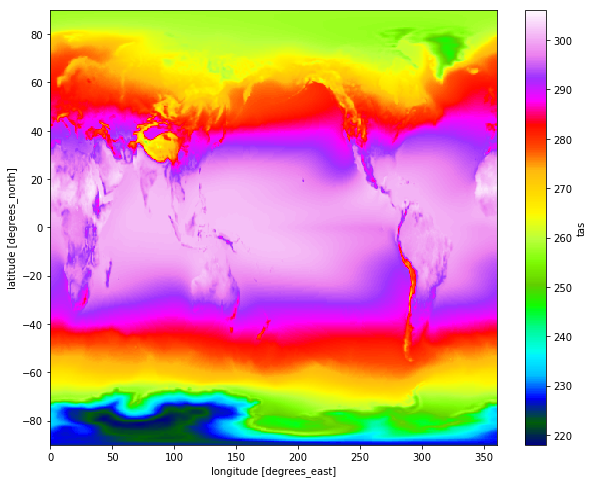

In [28]:
%timeit temp_mean.plot(figsize=[10, 8],cmap='gist_ncar') 

1min 25s ± 431 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


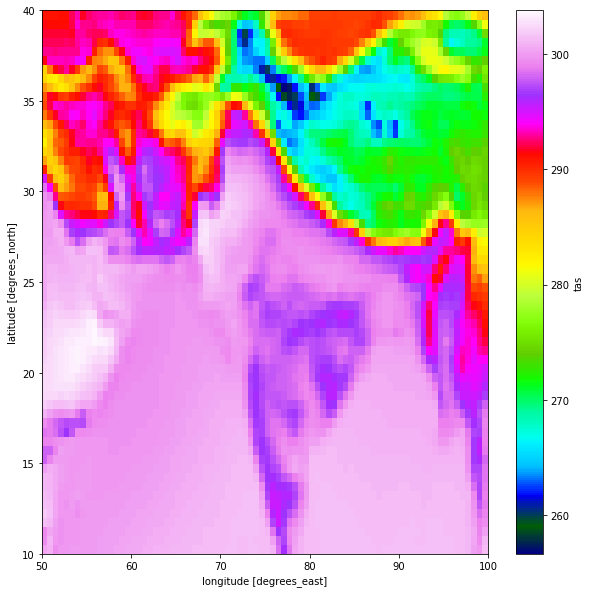

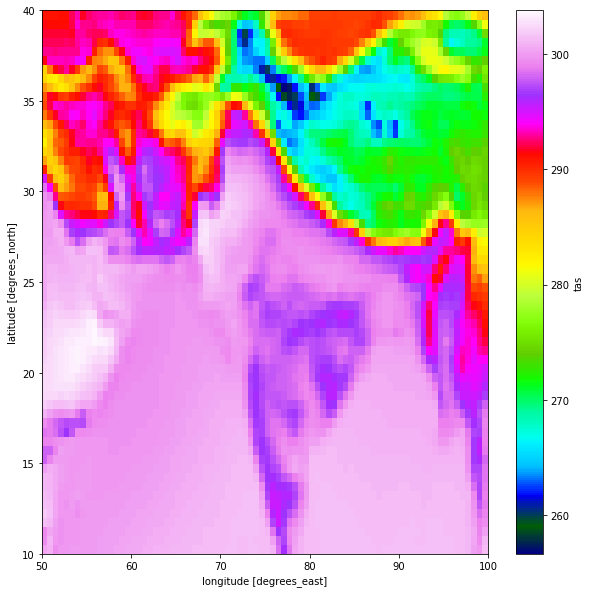

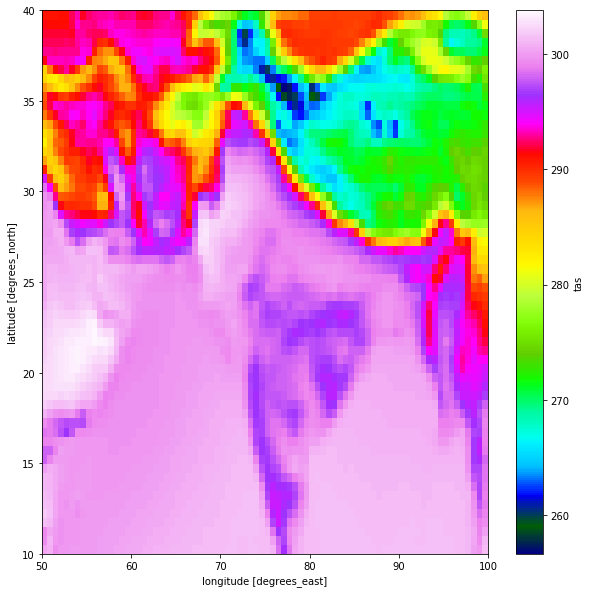

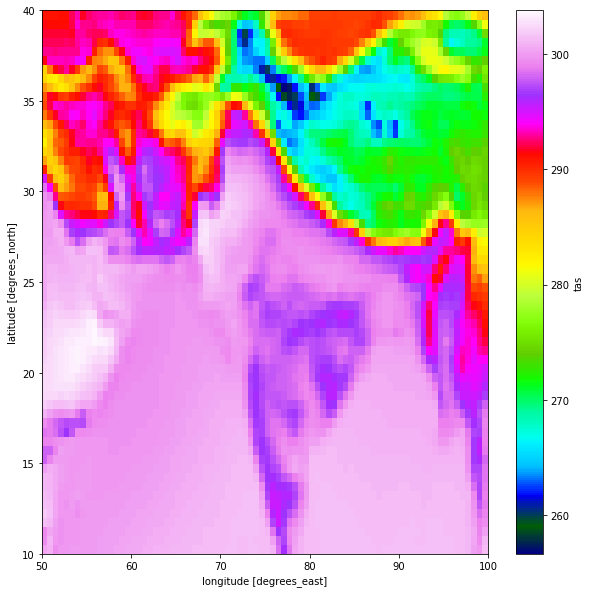

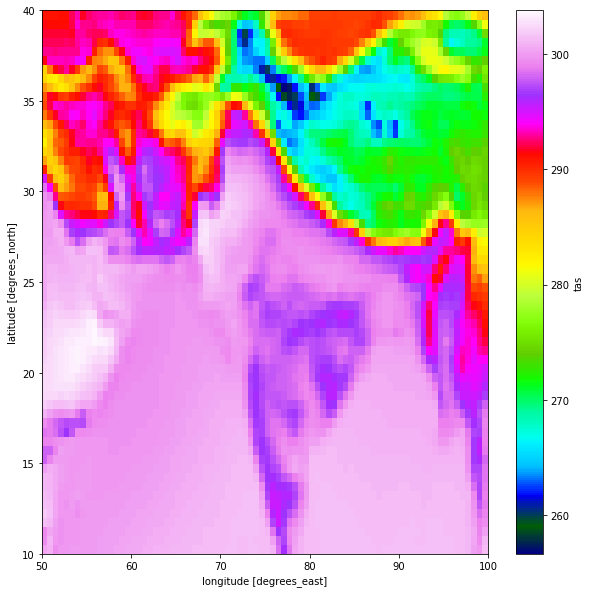

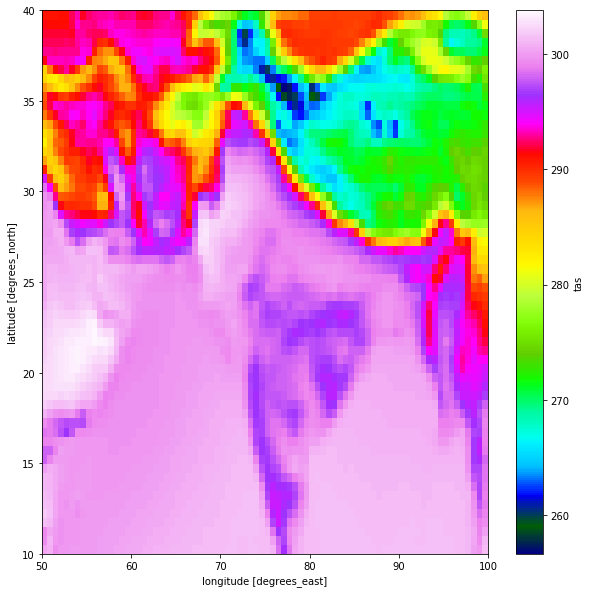

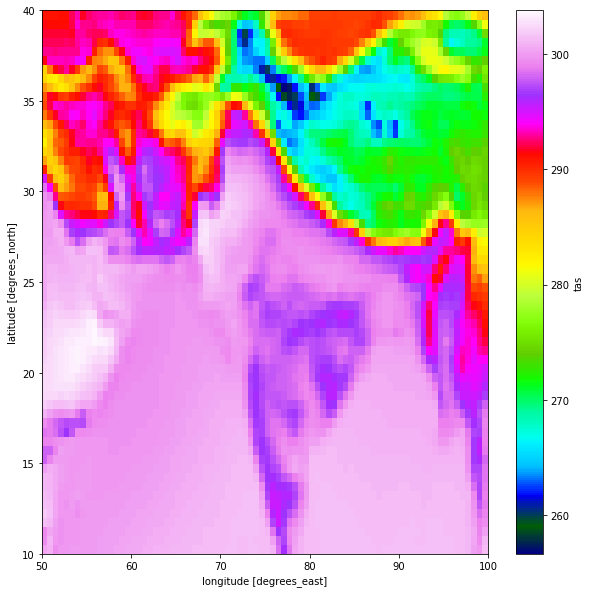

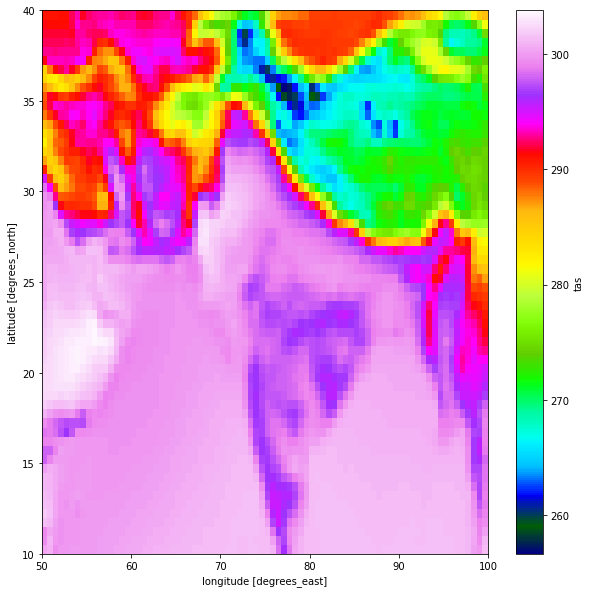

In [29]:
%timeit temp_mean.loc[10:40,50:100].plot(figsize=[10, 10],cmap='gist_ncar')#took 2 min 38seconds chunk on creation 

Case 3, %time ds2 = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 240}, combine='by_coords',parallel=True,decode_cf=False)

In [31]:
%timeit ds2 = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 240}, combine='by_coords',parallel=True,decode_cf=False)

12.8 s ± 89.5 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [32]:
ds2 = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 240}, combine='by_coords',parallel=True,decode_cf=False)

In [41]:
ds2['tas'].data

,Array,Chunk
Bytes,87.25 GB,199.07 MB
Shape,"(105192, 360, 576)","(240, 360, 576)"
Count,880 Tasks,439 Chunks
Type,float32,numpy.ndarray


In [33]:
temp_mean = ds2[varname].mean(dim=['time'])

1min 7s ± 369 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


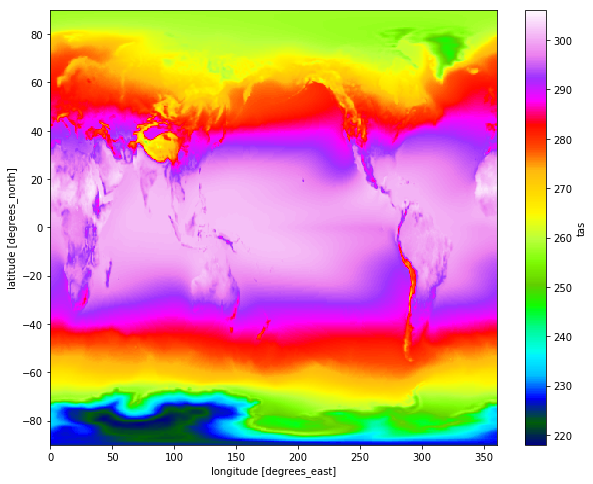

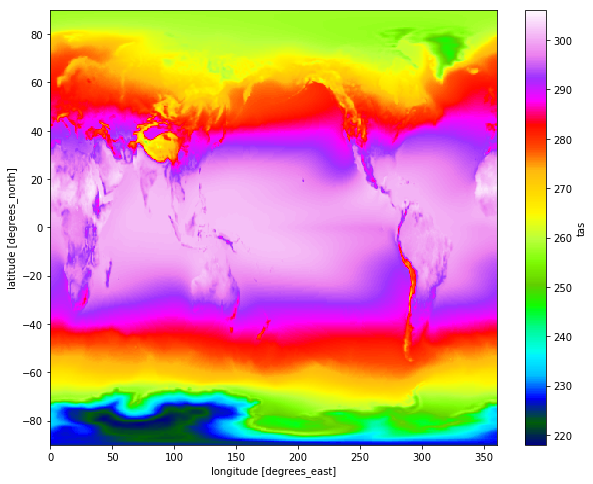

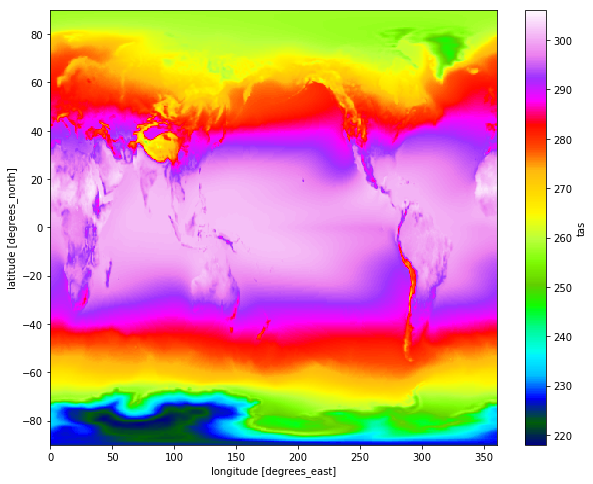

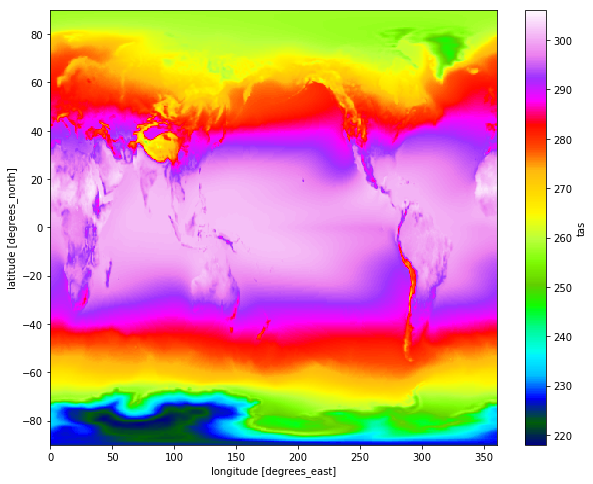

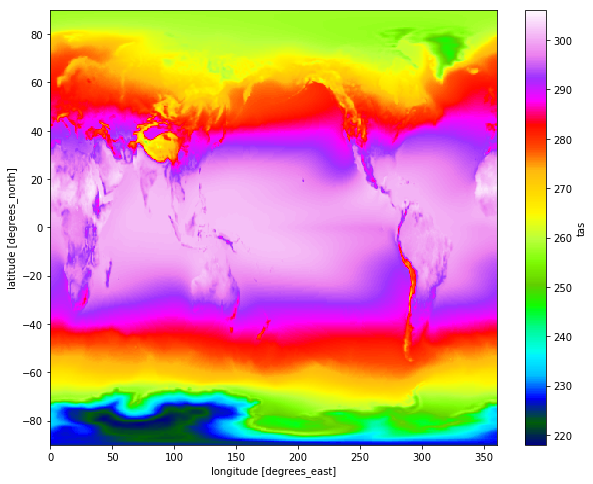

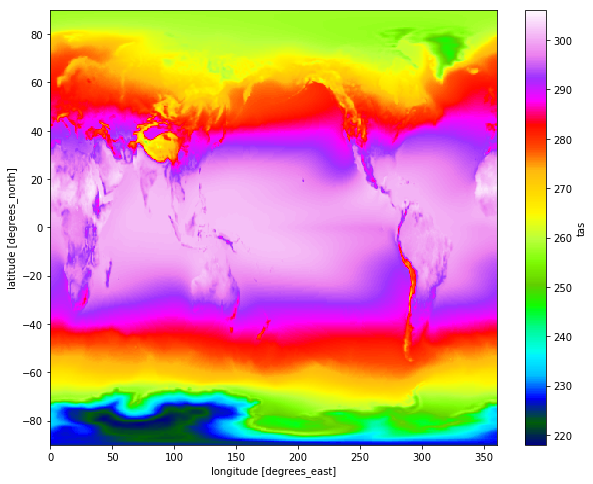

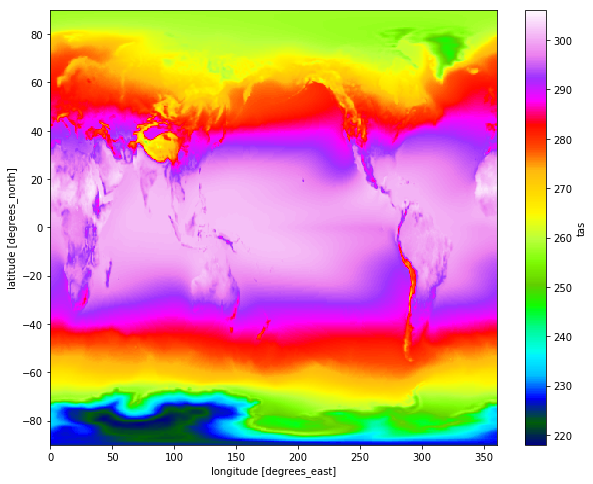

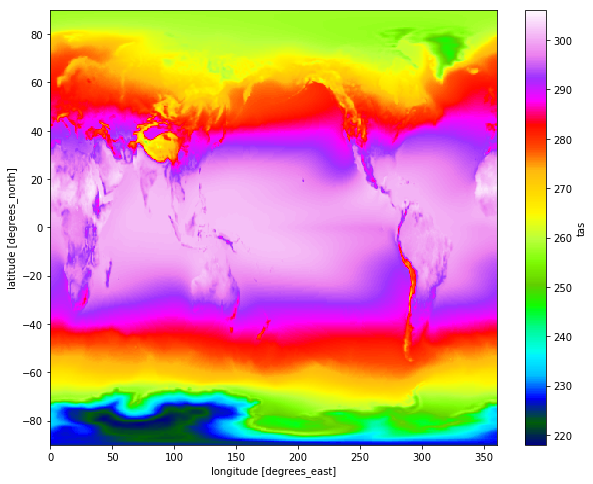

In [34]:
%timeit temp_mean.plot(figsize=[10, 8],cmap='gist_ncar') 

1min 7s ± 486 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


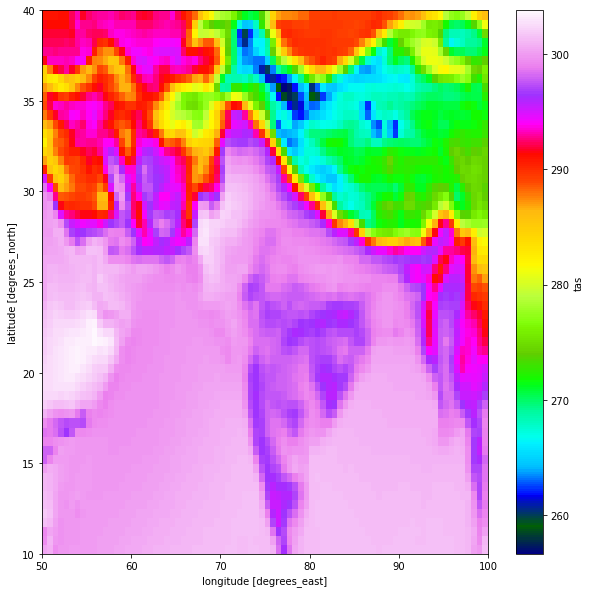

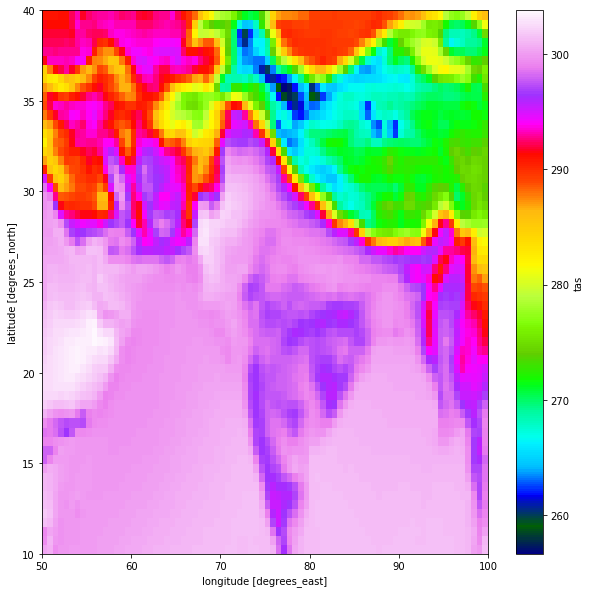

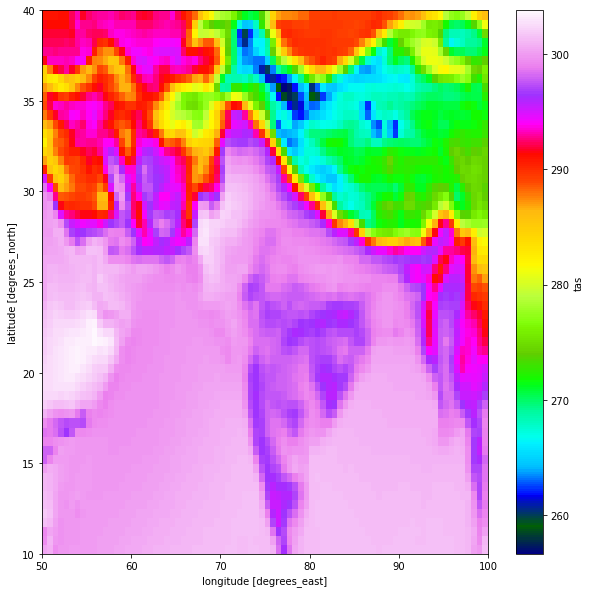

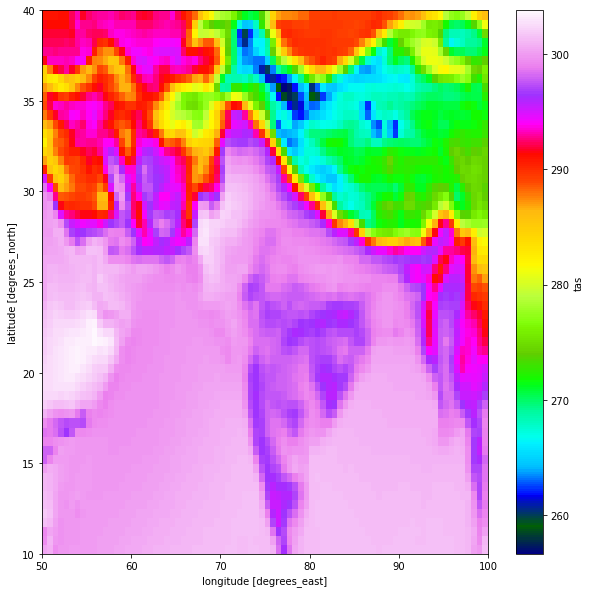

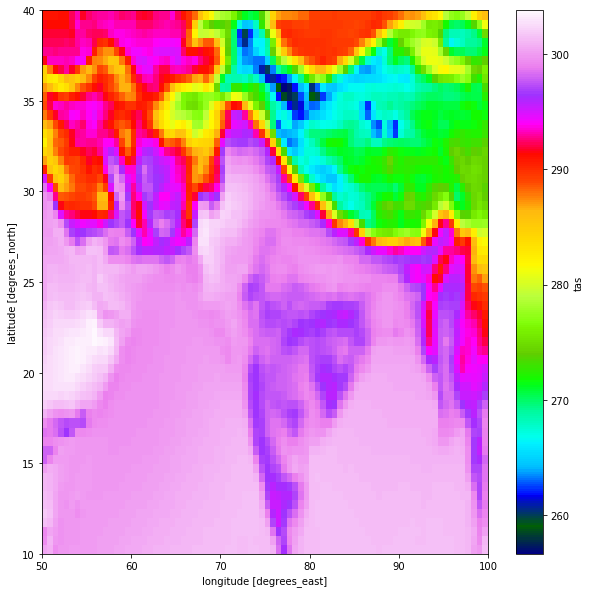

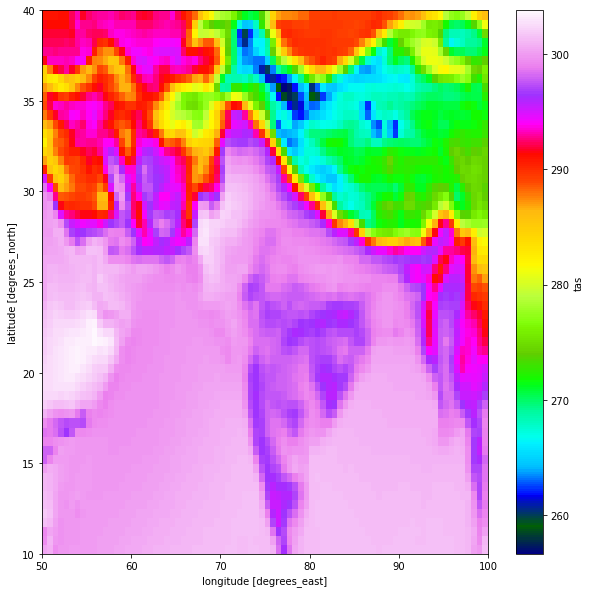

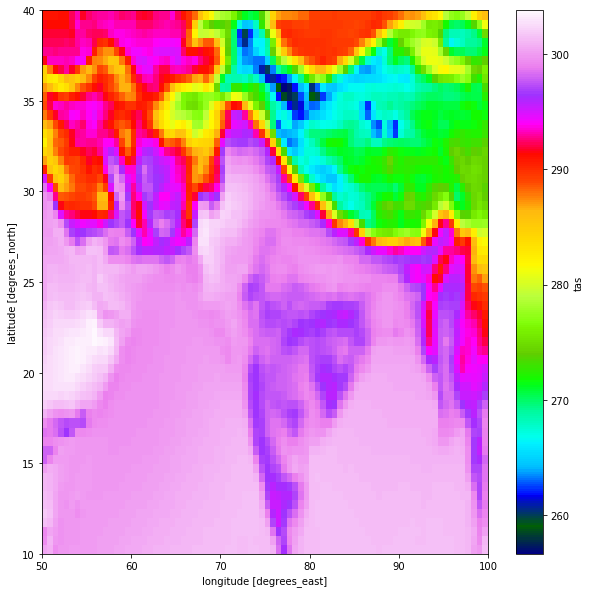

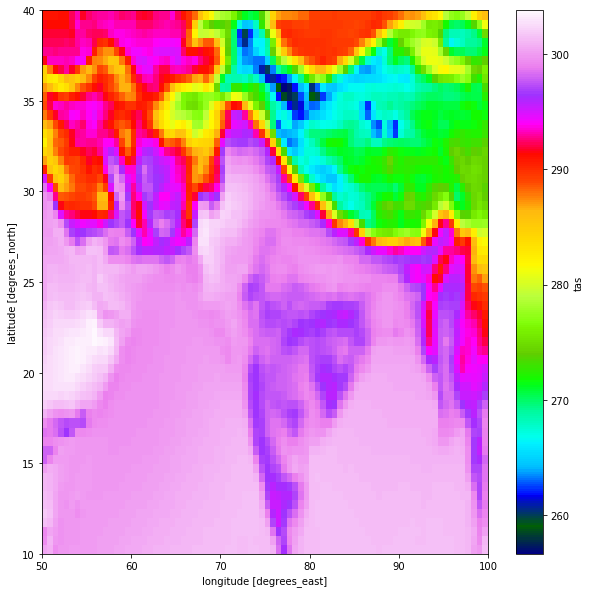

In [35]:
%timeit temp_mean.loc[10:40,50:100].plot(figsize=[10, 10],cmap='gist_ncar')#took 2 min 38seconds chunk on creation 

What if there are more chunks? time:1

In [36]:
%timeit ds3 = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 1}, combine='by_coords',parallel=True,decode_cf=False)

15.2 s ± 168 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [37]:
ds3 = xr.open_mfdataset(datadir + '*.nc', chunks={'time': 1}, combine='by_coords',parallel=True,decode_cf=False)

4min 38s ± 16.6 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


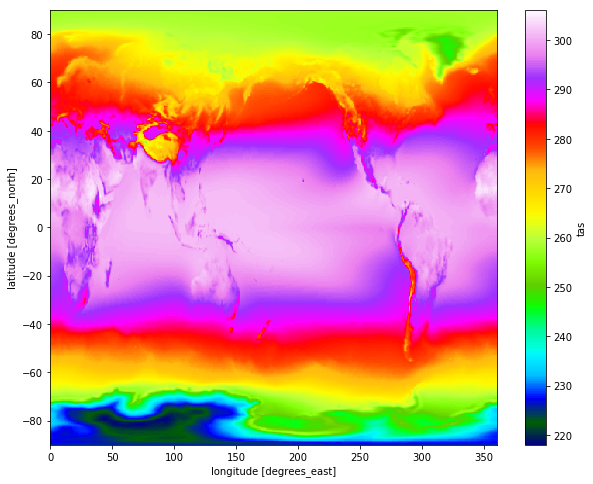

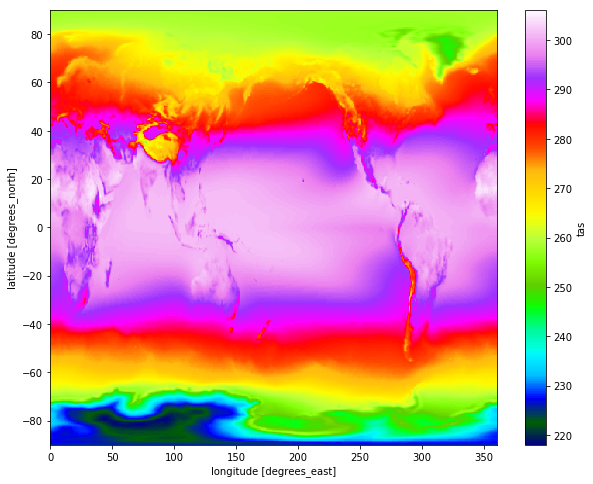

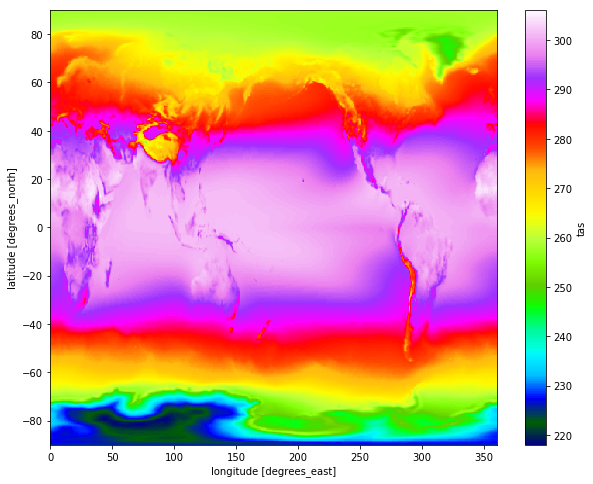

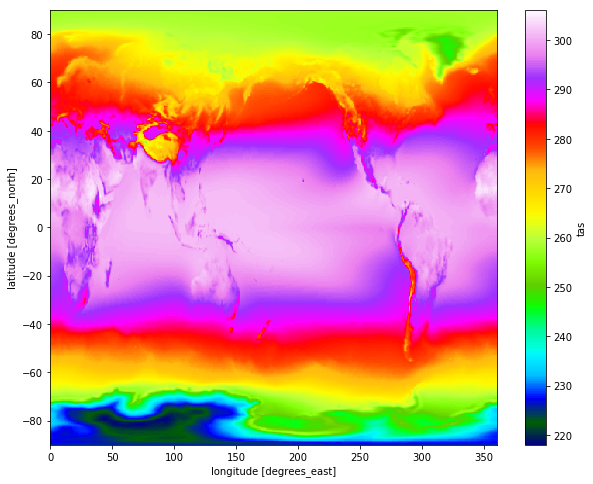

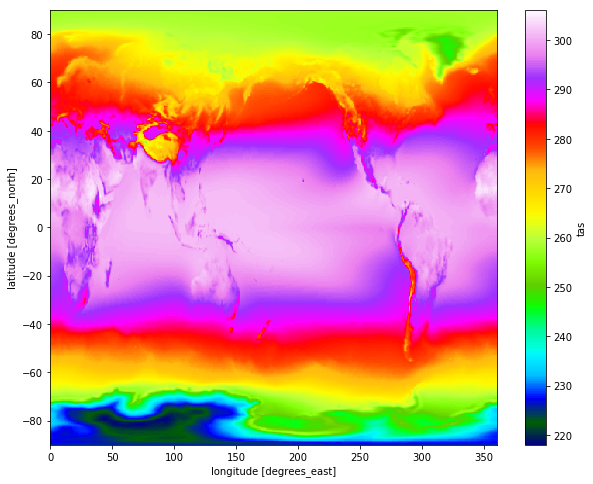

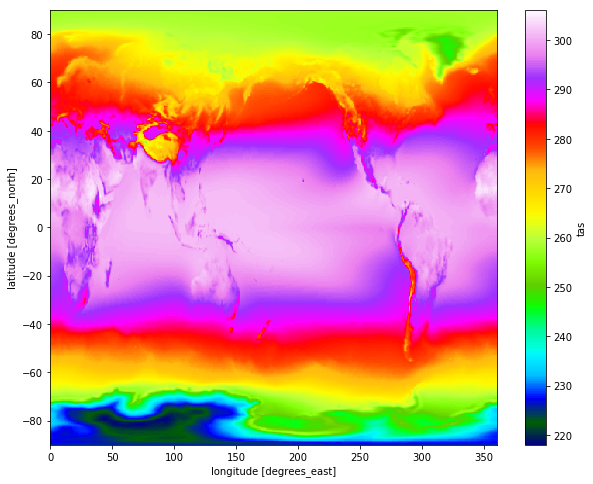

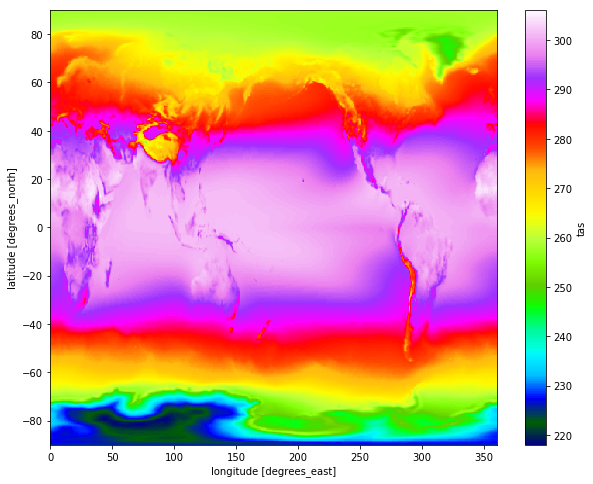

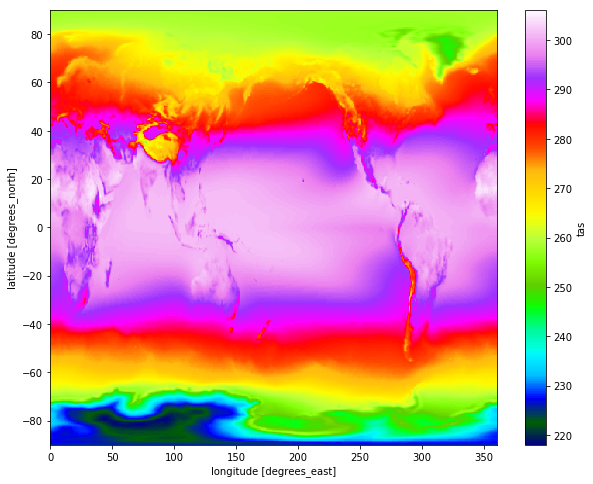

In [38]:
temp_mean = ds3[varname].mean(dim=['time'])
%timeit temp_mean.plot(figsize=[10, 8],cmap='gist_ncar') 

In [42]:
ds3['tas'].data

,Array,Chunk
Bytes,87.25 GB,829.44 kB
Shape,"(105192, 360, 576)","(1, 360, 576)"
Count,210386 Tasks,105192 Chunks
Type,float32,numpy.ndarray


In [39]:
client.close()
cluster.close()

In [40]:
#If we use chunks time:240 
#Open takes 1.46s
#Time ave plot takes 46.1seconds
#Plot a specific region takes 46s